# Build k-means classifier

## Train model (slower)

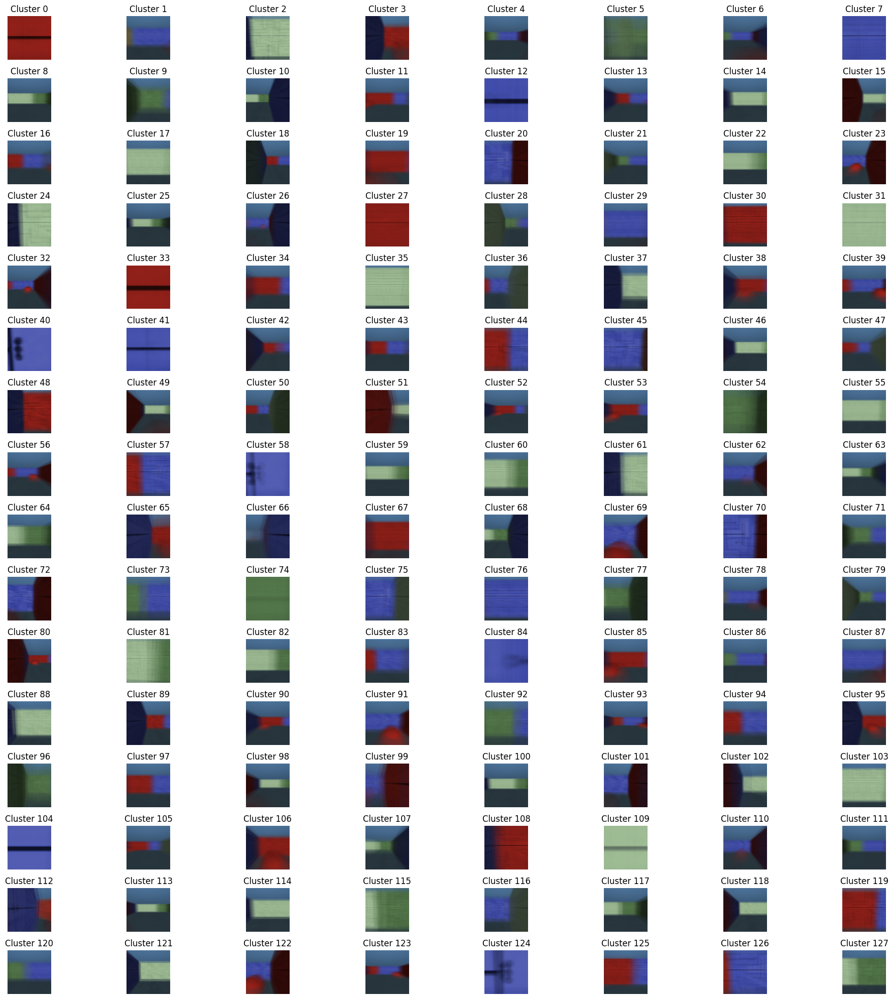

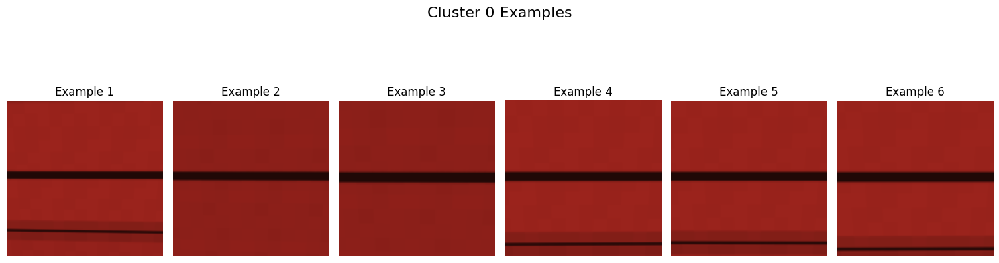

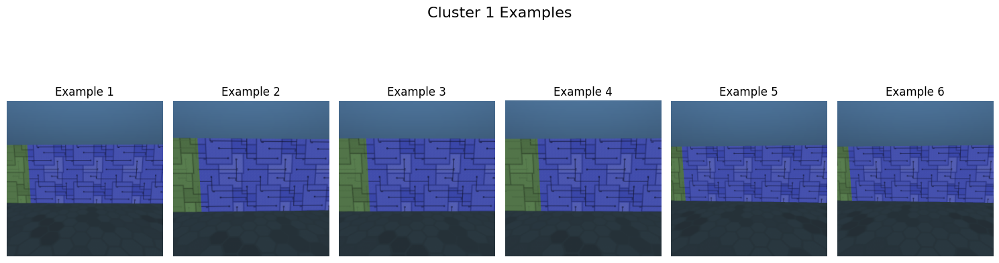

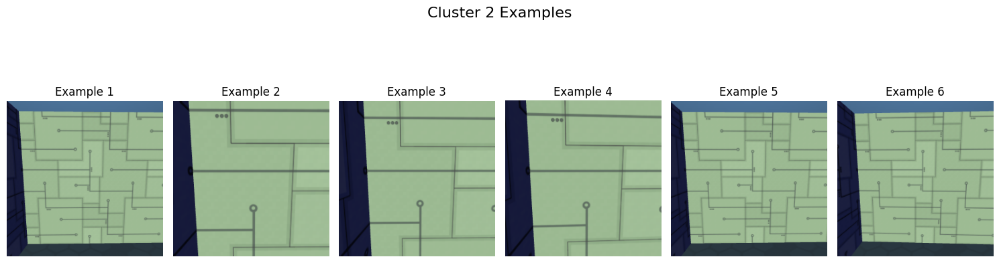

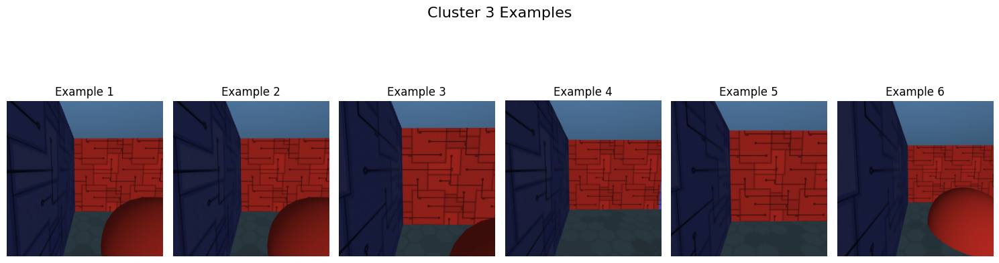

...

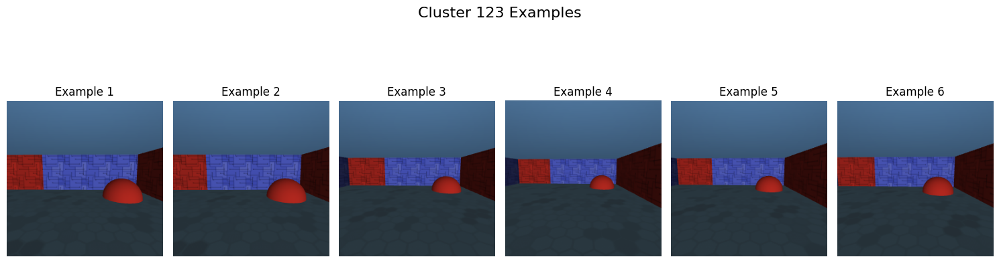

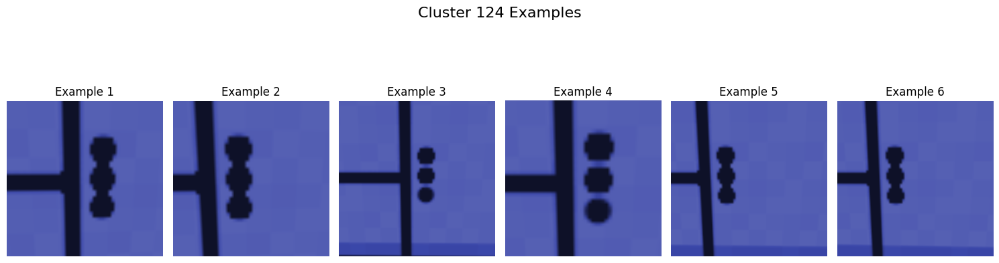

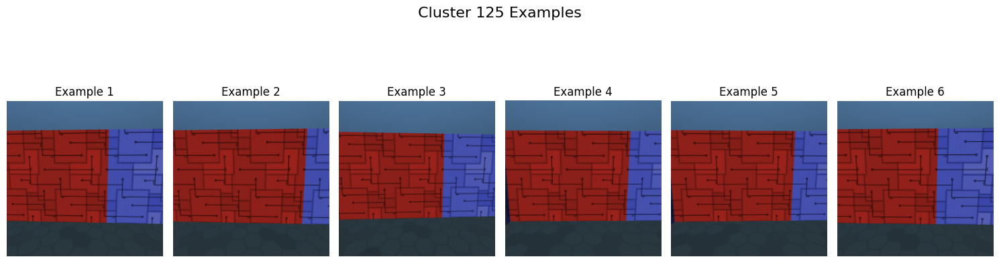

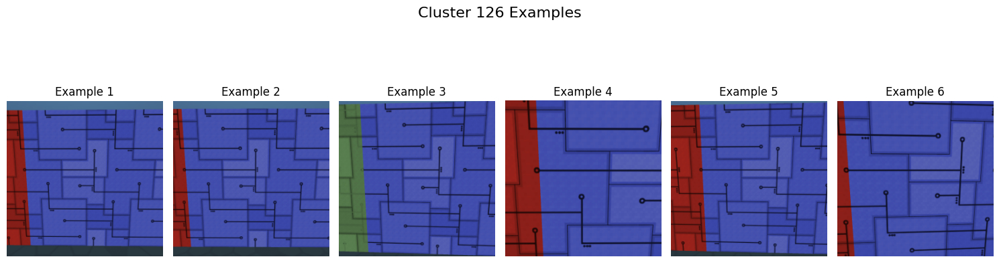

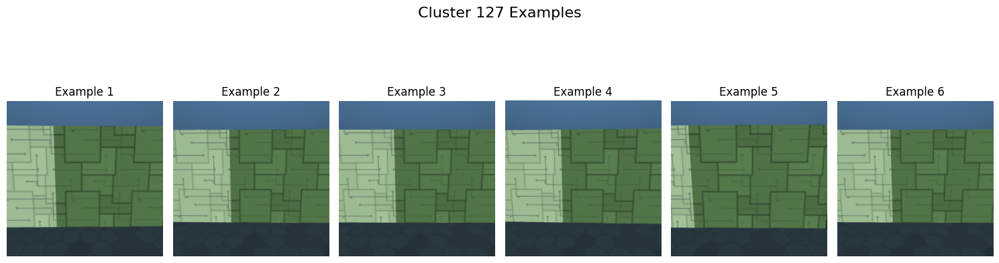

CPU times: user 16h 59min 25s, sys: 4min 41s, total: 17h 4min 7s
Wall time: 23min 42s


In [1]:
%%time
import numpy as np
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import pickle

# Load the saved data
data = np.load("../data/small_env_5_5_3actions_10k.npz")

# Extract the 'image' key from the data
# Assuming the shape of 'image' is (steps, height, width, channels)
images = data["image"]

# Reshape images for k-means clustering
# Flatten the height, width, and channels for clustering
flattened_images = images.reshape(images.shape[0], -1)

# Number of clusters for k-means
num_clusters = 128

# Perform k-means clustering
kmeans = KMeans(n_clusters=num_clusters, random_state=42)
kmeans.fit(flattened_images)


# Save the model to a file
with open('kmeans_model.pkl', 'wb') as file:
    pickle.dump(kmeans, file)

# Cluster labels for each observation
labels = kmeans.labels_

# Reshape each cluster center back into the original image shape
cluster_centers = kmeans.cluster_centers_
cluster_center_images = cluster_centers.reshape((num_clusters, *images.shape[1:]))

# Cast cluster centers to integers in range [0, 255]
cluster_center_images = np.clip(cluster_center_images, 0, 255).astype(np.uint8)

# Display cluster centers
rows = 16
cols = 8
fig, axes = plt.subplots(rows, cols, figsize=(20, 20))
axes = axes.ravel()

for i in range(num_clusters):
    axes[i].imshow(cluster_center_images[i])  # Cluster center image
    axes[i].set_title(f"Cluster {i}")
    axes[i].axis("off")

plt.tight_layout()
plt.show()

# Display examples for each cluster
for cluster_id in range(num_clusters):
    # Create a new figure for each cluster
    fig, axes = plt.subplots(1, 6, figsize=(15, 5))
    
    # Find up to 6 examples from this cluster
    cluster_examples = np.where(labels == cluster_id)[0][:6]  # Indices of images in this cluster
    
    for i, example_idx in enumerate(cluster_examples):
        example_image = images[example_idx].astype(np.uint8)  # Cast example image to uint8
        axes[i].imshow(example_image)  # Example image
        axes[i].set_title(f"Example {i + 1}")
        axes[i].axis("off")
    
    # Hide unused axes if fewer than 6 examples are found
    for i in range(len(cluster_examples), 6):
        axes[i].axis("off")
    
    fig.suptitle(f"Cluster {cluster_id} Examples", fontsize=16)
    plt.tight_layout()
    plt.show()


## Load kmeans model (faster)

In [2]:
import numpy as np
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import pickle

# Load the saved data
data = np.load("../data/memory_maze_100k.npz")

# Extract the 'image' key from the data
# Assuming the shape of 'image' is (steps, height, width, channels)
images = data["image"]

# Reshape images for k-means clustering
# Flatten the height, width, and channels for clustering
flattened_images = images.reshape(images.shape[0], -1)

# Number of clusters for k-means
num_clusters = 128

# Load the model from the file
with open('kmeans_model.pkl', 'rb') as file:
    kmeans = pickle.load(file)


# Cluster labels for each observation
labels = kmeans.labels_

# Reshape each cluster center back into the original image shape
cluster_centers = kmeans.cluster_centers_
cluster_center_images = cluster_centers.reshape((num_clusters, *images.shape[1:]))

# Cast cluster centers to integers in range [0, 255]
cluster_center_images = np.clip(cluster_center_images, 0, 255).astype(np.uint8)

# Display cluster centers
rows = 16
cols = 8
fig, axes = plt.subplots(rows, cols, figsize=(20, 20))
axes = axes.ravel()

for i in range(num_clusters):
    axes[i].imshow(cluster_center_images[i])  # Cluster center image
    axes[i].set_title(f"Cluster {i}")
    axes[i].axis("off")

plt.tight_layout()
plt.show()

# Display examples for each cluster
for cluster_id in range(num_clusters):
    # Create a new figure for each cluster
    fig, axes = plt.subplots(1, 6, figsize=(15, 5))
    
    # Find up to 6 examples from this cluster
    cluster_examples = np.where(labels == cluster_id)[0][:6]  # Indices of images in this cluster
    
    for i, example_idx in enumerate(cluster_examples):
        example_image = images[example_idx].astype(np.uint8)  # Cast example image to uint8
        axes[i].imshow(example_image)  # Example image
        axes[i].set_title(f"Example {i + 1}")
        axes[i].axis("off")
    
    # Hide unused axes if fewer than 6 examples are found
    for i in range(len(cluster_examples), 6):
        axes[i].axis("off")
    
    fig.suptitle(f"Cluster {cluster_id} Examples", fontsize=16)
    plt.tight_layout()
    plt.show()


ValueError: cannot reshape array of size 25165824 into shape (128,64,64,3)

# Get sequence from the single environment

## Run environment 100k steps (slower)

## Load 100k trajectory

In [3]:
import numpy as np
import pickle

# Load the saved environment data
data = np.load("../data/small_env_5_5_3actions_10k.npz")

# Extract the 'image' key from the data (assuming it exists)
images = data["image"]

# Reshape images for KMeans clustering
flattened_images = images.reshape(images.shape[0], -1)

# Load the saved KMeans model
with open('kmeans_model.pkl', 'rb') as file:
    kmeans = pickle.load(file)

# Apply the KMeans model to the observations
cluster_indices = kmeans.predict(flattened_images)

# Save the cluster index sequence to a file
np.save("../data/cluster_indices_10k.npy", cluster_indices)

print("Cluster index sequence saved to ../data/cluster_indices_10k.npy")

Cluster index sequence saved to ../data/cluster_indices_10k.npy


In [4]:
cluster_indices

array([16, 86, 16, ..., 56, 78, 78], dtype=int32)

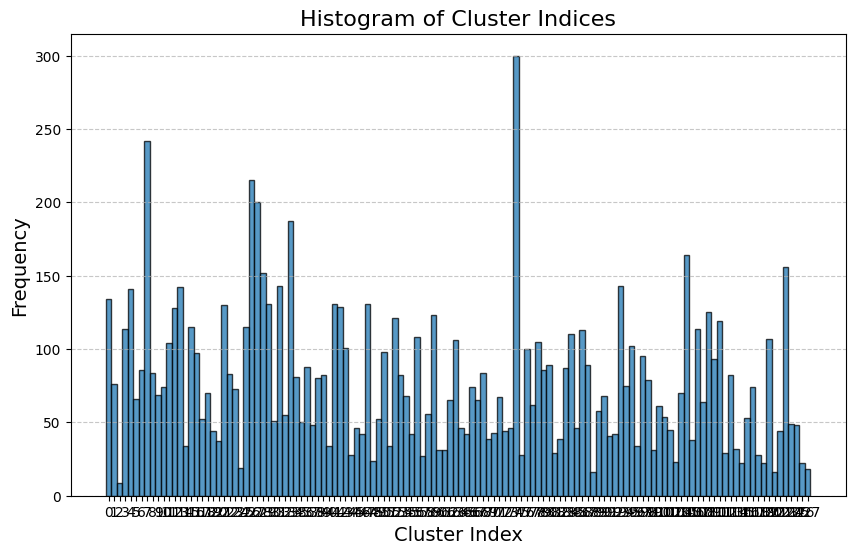

In [5]:
import numpy as np
import matplotlib.pyplot as plt

# Load the cluster indices
cluster_indices = np.load("../data/cluster_indices_10k.npy")

# Plot the histogram of cluster indices
plt.figure(figsize=(10, 6))
plt.hist(cluster_indices, bins=np.arange(cluster_indices.max() + 2) - 0.5, edgecolor='black', alpha=0.75)
plt.title("Histogram of Cluster Indices", fontsize=16)
plt.xlabel("Cluster Index", fontsize=14)
plt.ylabel("Frequency", fontsize=14)
plt.xticks(range(cluster_indices.max() + 1))  # Display all cluster indices
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

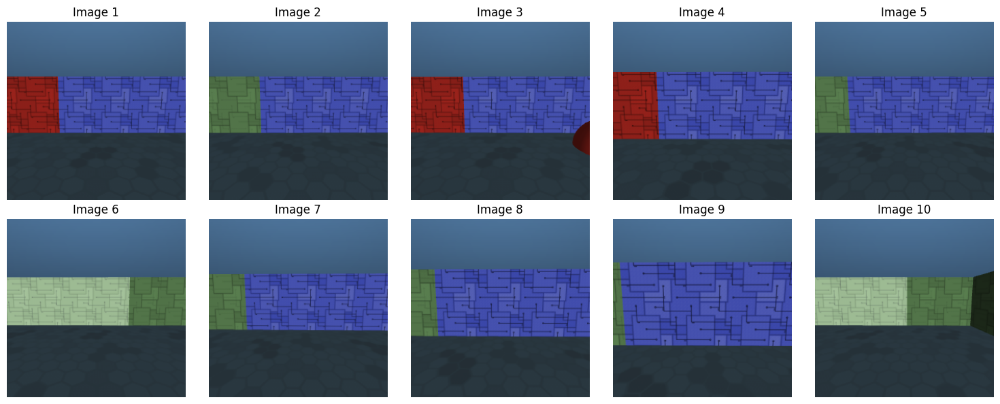

In [6]:
import numpy as np
import matplotlib.pyplot as plt

# Load the saved data
data = np.load("../data/small_env_5_5_3actions_10k.npz")

# Extract the 'image' key from the data
images = data["image"]

# Plot the first 10 images
plt.figure(figsize=(15, 6))
for i in range(10):
    plt.subplot(2, 5, i + 1)  # Create a grid of 2 rows and 5 columns
    plt.imshow(images[i], cmap='gray')  # Use 'gray' for grayscale images
    plt.title(f"Image {i+1}")
    plt.axis('off')  # Hide axes for better visualization

plt.tight_layout()
plt.show()

In [7]:
print([k for k in data.keys()])

['image', 'target_color', 'top_image', 'agent_pos', 'agent_dir', 'targets_vec', 'targets_pos', 'target_vec', 'target_pos', 'maze_layout', 'actions', 'error_values']


In [8]:
data['maze_layout'][0]

array([[0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0],
       [1, 1, 1, 0, 0],
       [1, 1, 1, 0, 0],
       [1, 1, 1, 0, 0]], dtype=uint8)

In [10]:
data = np.load("../data/small_env_5_5_3actions_10k.npz")

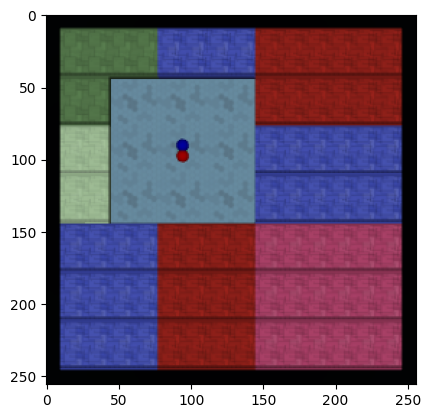

In [11]:
plt.imshow(data['top_image'][0])

In [12]:
data['agent_pos']

array([[1.5       , 3.5       ],
       [1.50013426, 3.50013875],
       [1.50027439, 3.5002784 ],
       ...,
       [0.86896645, 2.97858825],
       [1.10365158, 2.97301728],
       [1.34003397, 2.96742633]])

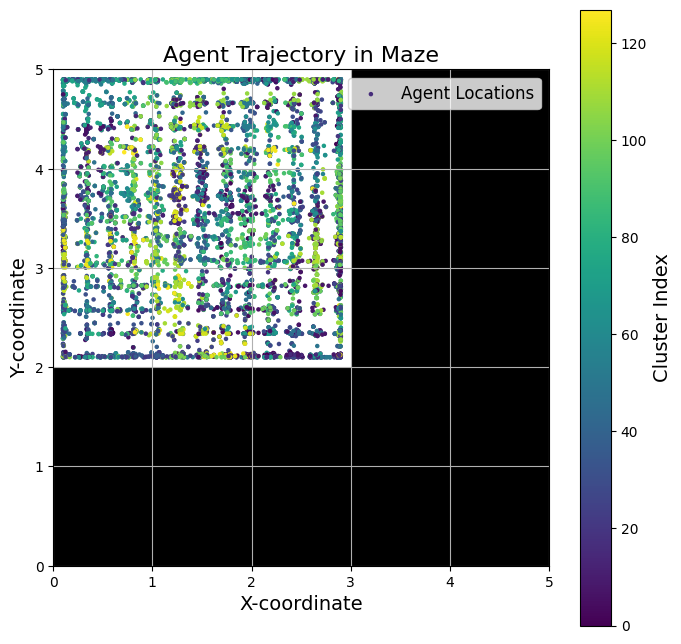

In [13]:
import numpy as np
import matplotlib.pyplot as plt

# Maze layout
maze = data['maze_layout'][0]


# Agent trajectory (sample data)
agent_locations = data['agent_pos']

# Plot the maze
plt.figure(figsize=(8, 8))
plt.imshow(maze, cmap="gray", origin="lower", extent=(0, maze.shape[1], 0, maze.shape[0]))

# Plot the agent's trajectory
# plt.plot(agent_locations[:, 0], agent_locations[:, 1], color="white", linewidth=.5, label="Agent Trajectory")
# Overlay the agent's trajectory with cluster indices as colored circles
sc = plt.scatter(agent_locations[:, 0], agent_locations[:, 1], c=cluster_indices, cmap="viridis", s=5, label="Agent Locations")

# Add a colorbar to show cluster indices
cbar = plt.colorbar(sc)
cbar.set_label("Cluster Index", fontsize=14)

# Add labels and legend
plt.title("Agent Trajectory in Maze", fontsize=16)
plt.xlabel("X-coordinate", fontsize=14)
plt.ylabel("Y-coordinate", fontsize=14)
plt.legend(fontsize=12)
plt.grid(True)
plt.show()

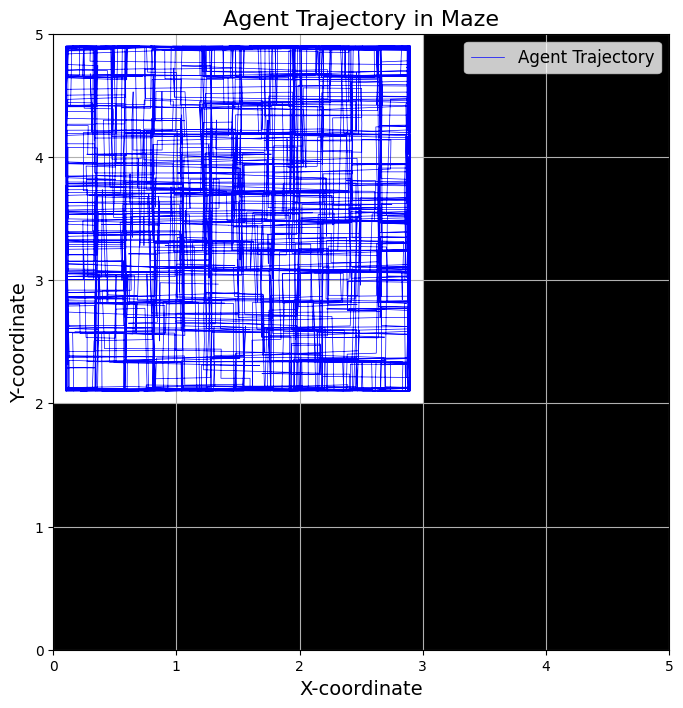

In [14]:
import numpy as np
import matplotlib.pyplot as plt

# Maze layout
maze = data['maze_layout'][0]


# Agent trajectory (sample data)
agent_locations = data['agent_pos']

# Plot the maze
plt.figure(figsize=(8, 8))
plt.imshow(maze, cmap="gray", origin="lower", extent=(0, maze.shape[1], 0, maze.shape[0]))

# Plot the agent's trajectory
plt.plot(agent_locations[:, 0], agent_locations[:, 1], color="blue", linewidth=.5, label="Agent Trajectory")
# Overlay the agent's trajectory with cluster indices as colored circles
# sc = plt.scatter(agent_locations[:, 0], agent_locations[:, 1], c=cluster_indices, cmap="viridis", s=5, label="Agent Locations")

# Add a colorbar to show cluster indices
# cbar = plt.colorbar(sc)
# cbar.set_label("Cluster Index", fontsize=14)

# Add labels and legend
plt.title("Agent Trajectory in Maze", fontsize=16)
plt.xlabel("X-coordinate", fontsize=14)
plt.ylabel("Y-coordinate", fontsize=14)
plt.legend(fontsize=12)
plt.grid(True)
plt.show()

In [15]:
%gui qt6

# import napari

ERROR:root:
    Could not load requested Qt binding. Please ensure that
    PyQt4 >= 4.7, PyQt5, PyQt6, PySide >= 1.0.3, PySide2, or
    PySide6 is available, and only one is imported per session.

    Currently-imported Qt library:                              None
    PyQt5 available (requires QtCore, QtGui, QtSvg, QtWidgets): False
    PyQt6 available (requires QtCore, QtGui, QtSvg, QtWidgets): False
    PySide2 installed:                                          False
    PySide6 installed:                                          False
    Tried to load:                                              ['pyqt6']
    


In [16]:
# viewer = napari.view_image(data['top_image'])

In [17]:
import sys
from pathlib import Path

# Add the parent directory to sys.path
parent_directory = Path.cwd().parent
sys.path.append(str(parent_directory))

# Import the module


In [18]:
import numpy as np
from chmm_actions import CHMM, forwardE, datagen_structured_obs_room
import matplotlib.pyplot as plt

import igraph
from matplotlib import cm, colors
import os

custom_colors = (
    np.array(
        [
            [214, 214, 214],
            [85, 35, 157],
            [253, 252, 144],
            [114, 245, 144],
            [151, 38, 20],
            [239, 142, 192],
            [214, 134, 48],
            [140, 194, 250],
            [72, 160, 162],
        ]
    )
    / 256
)
if not os.path.exists("figures"):
    os.makedirs("figures")


In [19]:
def plot_graph(
    chmm, x, a, output_file, cmap=cm.Spectral, multiple_episodes=False, vertex_size=10
):
    states = chmm.decode(x, a)[1]

    v = np.unique(states)
    if multiple_episodes:
        T = chmm.C[:, v][:, :, v][:-1, 1:, 1:]
        v = v[1:]
    else:
        T = chmm.C[:, v][:, :, v]
    A = T.sum(0)
    A /= A.sum(1, keepdims=True)

    g = igraph.Graph.Adjacency((A > 0).tolist())
    node_labels = np.arange(x.max() + 1).repeat(n_clones)[v]
    if multiple_episodes:
        node_labels -= 1
    colors = [cmap(nl)[:3] for nl in node_labels / node_labels.max()]
    out = igraph.plot(
        g,
        output_file,
        layout=g.layout("kamada_kawai"),
        vertex_color=colors,
        vertex_label=v,
        vertex_size=vertex_size,
        margin=50,
    )

    return out


def get_mess_fwd(chmm, x, pseudocount=0.0, pseudocount_E=0.0):
    n_clones = chmm.n_clones
    E = np.zeros((n_clones.sum(), len(n_clones)))
    last = 0
    for c in range(len(n_clones)):
        E[last : last + n_clones[c], c] = 1
        last += n_clones[c]
    E += pseudocount_E
    norm = E.sum(1, keepdims=True)
    norm[norm == 0] = 1
    E /= norm
    T = chmm.C + pseudocount
    norm = T.sum(2, keepdims=True)
    norm[norm == 0] = 1
    T /= norm
    T = T.mean(0, keepdims=True)
    log2_lik, mess_fwd = forwardE(
        T.transpose(0, 2, 1), E, chmm.Pi_x, chmm.n_clones, x, x * 0, store_messages=True
    )
    return mess_fwd


def place_field(mess_fwd, rc, clone):
    assert mess_fwd.shape[0] == rc.shape[0] and clone < mess_fwd.shape[1]
    field = np.zeros(rc.max(0) + 1)
    count = np.zeros(rc.max(0) + 1, int)
    for t in range(mess_fwd.shape[0]):
        r, c = rc[t]
        field[r, c] += mess_fwd[t, clone]
        count[r, c] += 1
    count[count == 0] = 1
    return field / count


In [20]:
data['actions'].shape

(10000,)

In [21]:
cluster_indices.max()

np.int32(127)

In [22]:
n_emissions = cluster_indices.max() + 1

# Calculate unique values and their counts
unique_values, counts = np.unique(cluster_indices, return_counts=True)

n_clones = np.ones(n_emissions, dtype=np.int64) * 70

x = cluster_indices.astype(np.int64)
a = data['actions'].astype(np.int64) - 1


In [39]:
unique_values

array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
       104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
       117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127], dtype=int32)

In [40]:
n_clones[unique_values] = counts * 10

In [41]:
n_clones

array([1340,  760,   90, 1140, 1410,  660,  860, 2420,  840,  690,  740,
       1040, 1280, 1420,  340, 1150,  970,  520,  700,  440,  370, 1300,
        830,  730,  190, 1150, 2150, 2000, 1520, 1310,  510, 1430,  550,
       1870,  810,  500,  880,  480,  800,  820,  340, 1310, 1290, 1010,
        280,  460,  420, 1310,  240,  520,  980,  340, 1210,  820,  680,
        420, 1080,  270,  560, 1230,  310,  310,  650, 1060,  460,  420,
        740,  650,  840,  390,  430,  670,  440,  460, 3000,  280, 1000,
        620, 1050,  860,  890,  290,  390,  870, 1100,  460, 1130,  890,
        160,  580,  680,  410,  420, 1430,  750, 1020,  340,  950,  790,
        310,  610,  540,  450,  230,  700, 1640,  380, 1140,  640, 1250,
        930, 1190,  290,  820,  320,  220,  530,  740,  280,  220, 1070,
        160,  440, 1560,  490,  480,  220,  180])

In [42]:
chmm = CHMM(n_clones=n_clones, pseudocount=1e-5, x=x, a=a, seed=42)

Average number of clones: 781.25


In [43]:
cluster_indices.dtype

dtype('int32')

In [ ]:
progression = chmm.learn_em_T(x, a, n_iter=10000, term_early=True)  # Training

  0%|                               | 1/10000 [04:38<772:10:33, 278.01s/it, train_bps=0.594]

In [47]:
chmm.pseudocount=0.0
chmm.learn_viterbi_T(x, a, n_iter=1000)

  0%|                                  | 1/1000 [01:17<21:32:11, 77.61s/it, train_bps=0.596]


[np.float32(0.5956043), np.float32(0.5956043)]

In [46]:
graph = plot_graph(
    chmm, x, a, output_file="figures/memory_maze_graph.pdf", cmap=cm.Reds
)
graph

In [34]:
n_clones = np.ones(n_emissions, dtype=np.int64) 

total = counts.sum() 
n_clones[unique_values] = (counts / total * 128 * 70).astype(np.int64) + 5

In [35]:
n_clones

array([125,  73,  13, 107, 131,  64,  82, 221,  80,  66,  71,  98, 119,
       132,  35, 108,  91,  51,  67,  44,  38, 121,  79,  70,  22, 108,
       197, 184, 141, 122,  50, 133,  54, 172,  77,  49,  83,  48,  76,
        78,  35, 122, 120,  95,  30,  46,  42, 122,  26,  51,  92,  35,
       113,  78,  65,  42, 101,  29,  55, 115,  32,  32,  63,  99,  46,
        42,  71,  63,  80,  39,  43,  65,  44,  46, 273,  30,  94,  60,
        99,  82,  84,  30,  39,  82, 103,  46, 106,  84,  19,  56,  65,
        41,  42, 133,  72,  96,  35,  90,  75,  32,  59,  53,  45,  25,
        67, 151,  39, 107,  62, 117,  88, 111,  30,  78,  33,  24,  52,
        71,  30,  24, 100,  19,  44, 144,  48,  48,  24,  21])

In [36]:
n_emissions = cluster_indices.max() + 1


x = cluster_indices.astype(np.int64)
a = data['actions'].astype(np.int64) - 1 

chmm = CHMM(n_clones=n_clones, pseudocount=2e-3, x=x, a=a, seed=42)

progression = chmm.learn_em_T(x, a, n_iter=10000, term_early=True)  # Training


Average number of clones: 74.5390625


  1%|▎                                 | 109/10000 [01:32<2:20:35,  1.17it/s, train_bps=2.3]


In [37]:
chmm.pseudocount=0.0
chmm.learn_viterbi_T(x, a, n_iter=1000)

  0%|                                      | 3/1000 [00:01<07:50,  2.12it/s, train_bps=1.49]


[np.float32(2.3130126),
 np.float32(1.4885366),
 np.float32(1.4882411),
 np.float32(1.4882411)]

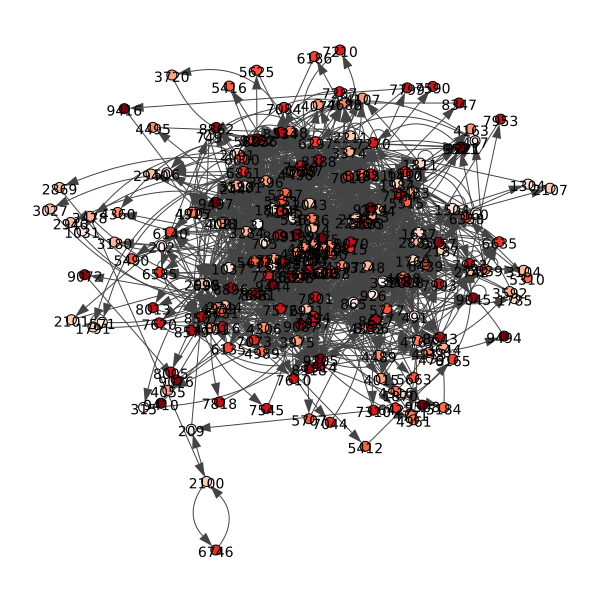

In [38]:
graph = plot_graph(
    chmm, x, a, output_file="figures/memory_maze_graph_clone_variable.pdf", cmap=cm.Reds
)
graph

In [ ]:
a